#**Código Abierto del Amazonas**
##Caso de estudio para el análisis y monitoreo de El Amazonas 🎖️

El Amazonas constituye un patrimonio natural invaluable para Colombia y el planeta, por su biodiversidad, sus servicios ecosistémicos y su importancia sociocultural. Por lo anterior, se busca aportar mediante este proyecto una herramienta que sea capaz de apoyar el proceso de salvaguarda que realiza la FAC sobre esta región.

Esta libreria contiene el código fuente necesario para realizar el proceso de imagenes capturadas mediante dispositivos aerotransportados por la Fuerza Aérea Colombiana. Así, son tres cuestiones principales que permite este código: i) mediante palabras claves, los usuarios pueden segmentar e identificar en fotogramas, diversos elementos de interés según los requerimientos explícitos que se deseen identificar; ii) si los oficiales de la FAC conocen las coordenadas (en formato de latitud y longitud) pueden utilizar el mapa interactivo que hemos diseñado para que, manualmente, seleccionen en el mapa global las áreas que desean analizar mediante palabras claves. Este es un aspecto que puede brindar mayores elementos de juicio para contrastar con los datos audiovisuales capturados por la FAC, y; iii) mediante la conversión de videos a fotogramas se podrá extraer la cantidad de objetos, el tiempo correspondiente en el video y las coordenadas para que sean exportadas a un documento con formato .CSV con el fin de que se pueda realizar el análisis posterior que sea pertinente.



 #**PARTE 1: ANÁLISIS DE FOTOGRAMAS A ELECCIÓN**

## Instalar dependencias 💻

El usuario deberá instalar las dependencias de código abierto que permitirán realizar la segmentación, y las inferencias para la identificación de objetos mediante palabras claves.


In [ ]:
%pip install segment-geospatial groundingdino-py leafmap localtileserver

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.3/82.3 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 30.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 72.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 52.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 61.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 85.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 82.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.9/200.9 kB 16

In [ ]:
#Estas líneas de código importan tres librerías que se utilizan para segmentar imágenes geoespaciales con el modelo Segment Anything Model (SAM).
#Leafmap es una librería para crear mapas interactivos con Python
#Samgeo es una librería que adapta el código de SAM para trabajar con datos geoespaciales
#tms_to_geotiff es una función de samgeo que descarga y fusiona los mosaicos de mapas en un solo archivo GeoTIFF
#LangSAM es una clase de samgeo que permite segmentar objetos seleccionados mediante palabras clave
import leafmap
from samgeo import tms_to_geotiff
from samgeo.text_sam import LangSAM

##Cargue Manual de fotogramas 📷

El usuario debe cargar al entorno de ejecución de esta libreria el archivo que corresponda al fotograma de los videos.

Teniendo en cuenta que en la tercera parte de esta solución se realizará el procesamiento de videos completos, esta sección es un "plus" para quienes deseen analizar imagenes puntuales mediante la selección a través de Lenguaje Natural.

In [ ]:
#El usuario debe cargar el fotograma concreto al almacenamiento local y debe indicar la ubicación a continuación.
#Se recomienda que el usuario cargue el fotograma en formato .tif (tener cuenta que .tiff obedece a otro tipo de formato que puede presentar inconvenientes).
image = '/content/palabra_clave.tif'

## Configuración de la clase LangSAM 🗺️

La configuración de LangSAM puede tardar unos minutos, pues en ella se estructuran los pesos del modelo y los parámetros para realizar las inferencias con el fin de que las solicitudes de Lenguaje Natural sean procesadas y permitan la identificación y clasificación de los elementos potencialmente georeferenciables.

In [ ]:
sam = LangSAM()

final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Downloading: "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth" to /root/.cache/torch/hub/checkpoints/sam_vit_h_4b8939.pth
100%|██████████| 2.39G/2.39G [00:41<00:00, 61.6MB/s]


## Solicitud mediante Lenguaje Natural 🪖📝

En este punto, el usuario podrá ingresar la palabra que define el elemento que quiere segmentar e identificar en los fotogramas. Se sugiere introducir el texto en idioma inglés para mayor precisión en la asociación dentro de la imagen. Por ejemplo, si desea identificar un lago, introduzca “lake”, máquina "machine" o "engine", edificaciones "building", carros "car", excavadora "digger", lancha "boat", muelle "pier", entre otros.

In [ ]:
text_prompt = "lake"

In [ ]:
#Es crucial que antes de ejecutar esta línea de código se haya cargado el fotograma en formato .tif y el respectivo nombre y "path" se encuentre indicado desde la variable previa de "image="
sam.predict(image, text_prompt, box_threshold=0.24, text_threshold=0.24)

## Segmentación de imagenes. ✔

Este modelo permite fijar parámetros apropiados para la detección de objetos y la asociación de texto con los objetos detectados. Estos valores van de 0 a 1 y se establecen al llamar al método de predicción de la clase LangSAM.

box_threshold: este valor se utiliza para la detección de objetos en la imagen. Un valor más alto hace que el modelo sea más selectivo, identificando solo los objetos más confiables, generando menos detecciones generales. Por el contrario, un valor más bajo hace que el modelo sea más tolerante, lo que lleva a un aumento de las detecciones, incluidas las potencialmente menos seguras.

text_threshold: este valor asocia los objetos detectados con el mensaje de texto proporcionado. Un valor más alto requiere una asociación más fuerte entre el objeto y el mensaje de texto, lo que lleva a asociaciones más precisas pero con menores resultados. Un valor más bajo permite asociaciones más flexibles, lo que podría aumentar el número de asociaciones pero también introducir coincidencias menos precisas.

Se recomienda al usuario probar diferentes valores dentro de los parámetros establecidos para los datos específicos, aclaramos que el umbral óptimo puede variar según la calidad y la naturaleza de las imágenes que los oficiales de la FAC introduzcan, así como la especificidad de sus mensajes de texto.

## Visor de resultados 🔒

Una vez establecidos y ejecutados los parámetros para las inferencias, el usuario podrá visualizar los resultados que serán señalados en cuadros delimitantes sobre la imagen.

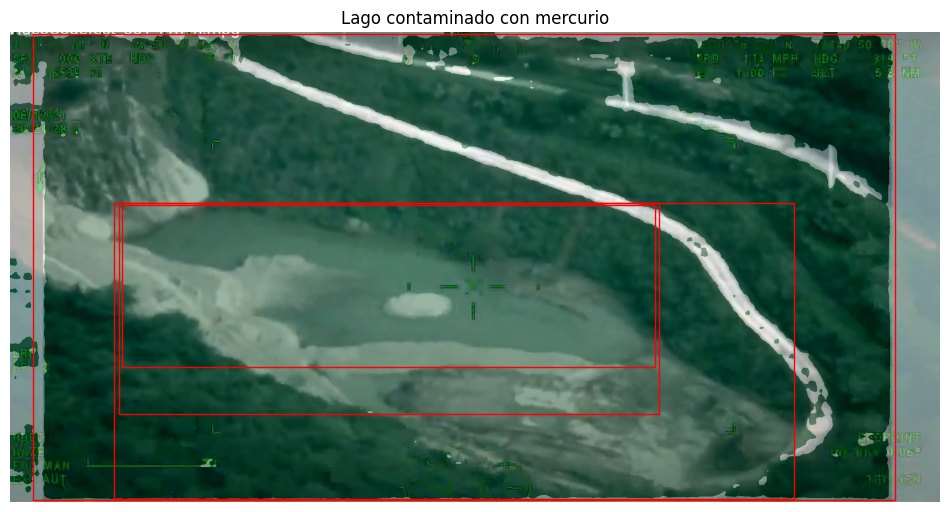

In [ ]:
sam.show_anns(
    cmap='Greens',
    box_color='red',
    title='Lago contaminado con mercurio',
    blend=True,
)

#**PARTE 2: MAPA INTERACTIVO PARA IDENTIFICAR OBJETOS DE INTERES CUANDO SÓLO SE CONOZCAN LAS COORDENADAS Y EL MATERIAL AUDIOVISUAL SEA INSUFICIENTE** ✍

Desde el equipo Código Abierto del Amazonas, nuestra prioridad es brindar un rango de posibilidades a la honorable Fuerza Aérea Colombiana para que puedan afrontar de manera efectiva las situaciones que ponen en riesgo a nuestro país. Por lo anterior, en este punto también proponemos un mecanismo complementario para que los oficiales de la FAC puedan interactuar con una interfaz visual que les permita seleccionar zonas de cualquier parte del mundo con base a las coordenadas en formato de Latitud y Longitud, con el fin de que sean seleccionadas áreas específicas con herramientas propias de la interfaz para que sean procesadas -nuevamente- desde requerimientos en Lenguaje Natural.



## Ejecución del mapa interactivo

In [ ]:
#Estimados oficiales de la FAC, noten cómo dentro de los corchetes cuadrados "[]" se encuentran las coordenadas que ustedes pueden modificar para buscar zonas especificas en el mapa interactivo.
#Es de resaltar que el area que se observa en el mapa interactivo fue seleccionada con base a los videos facilitados por la FAC durante el CODEFEST AD ASTRA 2023.
m = leafmap.Map(center=[1.928278, -69.577854], zoom=18, height="800px")
m.add_basemap("SATELLITE")
m

Map(center=[1.928278, -69.577854], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…

## Descargar una imagen para procesar

Desplace y amplíe el mapa para seleccionar el área donde requiere identificar objetos (o situaciones como en el ejemplo que verá más adelante) de interés. Utilice las herramientas de dibujo para establecer un polígono o rectángulo en el mapa para la extracción de una imagen del mapa.

In [ ]:
#Antes de ejecutar este código, por favor seleccione en el mapa el area que desea analizar.
bbox = m.user_roi_bounds()
if bbox is None:
    bbox = [1.928278, -69.577854]

In [ ]:
#Antes de ejecutar este código, por favor seleccione en el mapa la area que desea analizar.
#Dependiendo de lo que usted haya seleccionado, se descargará la imagen para que el modelo pre-entrenado pueda establecer las inferencias más adelante.
image = "Image.tif"
tms_to_geotiff(output=image, bbox=bbox, zoom=19, source="Satellite", overwrite=True)

Downloaded image 01/56
Downloaded image 02/56
Downloaded image 03/56
Downloaded image 04/56
Downloaded image 05/56
Downloaded image 06/56
Downloaded image 07/56
Downloaded image 08/56
Downloaded image 09/56
Downloaded image 10/56
Downloaded image 11/56
Downloaded image 12/56
Downloaded image 13/56
Downloaded image 14/56
Downloaded image 15/56
Downloaded image 16/56
Downloaded image 17/56
Downloaded image 18/56
Downloaded image 19/56
Downloaded image 20/56
Downloaded image 21/56
Downloaded image 22/56
Downloaded image 23/56
Downloaded image 24/56
Downloaded image 25/56
Downloaded image 26/56
Downloaded image 27/56
Downloaded image 28/56
Downloaded image 29/56
Downloaded image 30/56
Downloaded image 31/56
Downloaded image 32/56
Downloaded image 33/56
Downloaded image 34/56
Downloaded image 35/56
Downloaded image 36/56
Downloaded image 37/56
Downloaded image 38/56
Downloaded image 39/56
Downloaded image 40/56
Downloaded image 41/56
Downloaded image 42/56
Downloaded image 43/56
Downloaded 

##Mostrar la imagen descargada en el mapa interactivo

In [ ]:
m.layers[-1].visible = True
m.add_raster(image, layer_name="Image")
m

INFO:large_image:Cannot use memcached for caching.
INFO:large_image:Using python for large_image caching


Map(bottom=33195307.0, center=[1.9282782796394105, -69.577853679657], controls=(ZoomControl(options=['position…

## Inicializar la clase LangSAM

La inicialización de la clase LangSAM puede llevar unos minutos. La inicialización descarga los pesos del modelo y configura el modelo para la inferencia sobre la imagen que seleccionó previamente.

In [ ]:
sam = LangSAM()

final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


##Por favor ingrese la palabra clave que desea sea identificada en la imagen que seleccionó y descargó previamente

In [ ]:
#Dentro de las "" deberá ingresar la palabra clave a identificar.
text_prompt = "deforestation"

## Umbrales para la segmentación de imagen

Al igual que en la primera parte, la predicción del modelo incluye el establecimiento de umbrales adecuados para la detección de objetos y la asociación de texto con los objetos detectados. Estos valores de umbral van de 0 a 1 y se establecen al llamar al método predict de la clase LangSAM. Por favor remitase a los comentarios antecedentes de la primera parte que hablan de los umbrales (box y text) ya que la misma lógica aplica en esta parte.

Recuerde, usted es libre de probar diferentes valores de umbral (threshold) en sus datos específicos. El umbral óptimo puede variar en función de la calidad y la naturaleza de las imágenes, así como de la especificidad de las indicaciones textuales. Asegúrese de elegir un equilibrio que se adapte a las necesidades de la honorable Fuerza Aérea Colombiana, ya sean de precisión o de recuperación.

In [ ]:
sam.predict(image, text_prompt, box_threshold=0.24, text_threshold=0.24)

## Visualice los resultados

Estimado oficial de la FAC, con la ejecución del siguiente código usted habrá finalizado el proceso de análisis de imagen mediante la interfaz visual propuesta en esta segunda parte del proyecto.

Después de la imagen que segmenta y señala con un recuadro una situación, comunicada al modelo mediante lenguale natural, como la deforestación (la cual usted puede descargar directamente con click derecho), se encontrará con la tercera parte de este proyecto, la cual permitirá aplicar el modelo utilizado hasta el momento para que de forma más automatizada se realice la extracción de fotogramas mediante FFmpeg y posteriormente se exporte la información a un archivo con formato .CSV.  

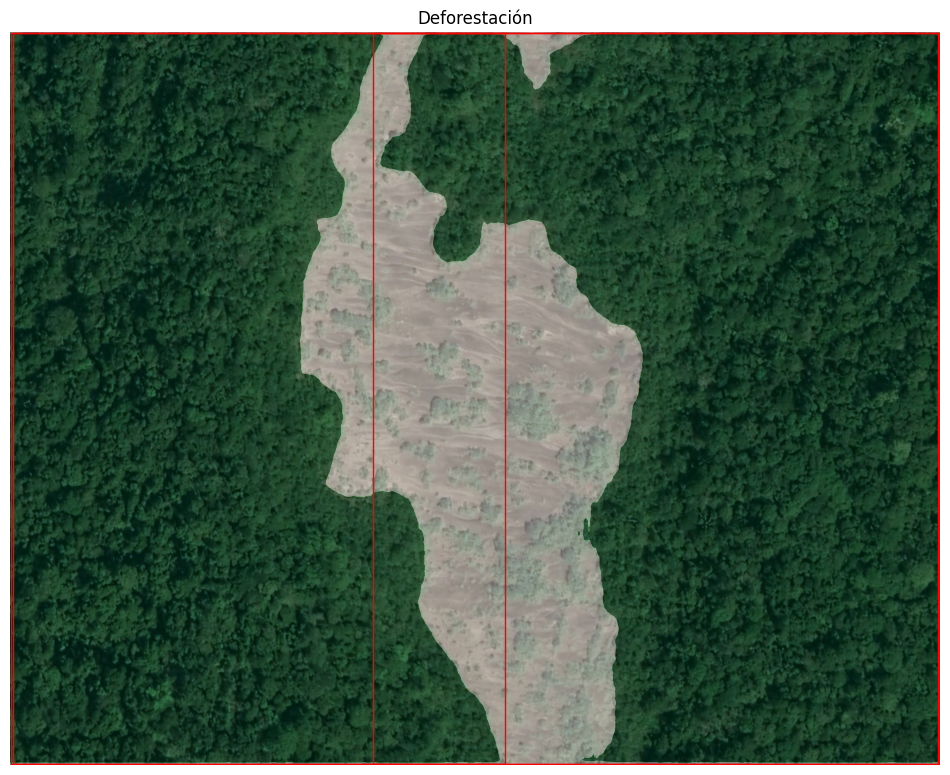

In [ ]:
sam.show_anns(
    cmap='Greens',
    box_color='red',
    title='Deforestación',
    blend=True,
)

#**PARTE 3: PROCESAMIENTO DE VIDEOS Y EXPORTACIÓN**

Esta parte tiene algunas falencias que se pueden mejorar en el futuro. Por ejemplo, la precisión y la velocidad con la que se procesan las coordenadas y la hora de los videos no es óptima, lo que puede afectar la calidad de los resultados. Asimismo, la discriminación de objetos de interés puede ser más adecuada si se utilizan modelos con mayor entrenamiento aplicable al caso de estudio, pues  la identificación hasta el momento no presenta altos niveles de precisión cuando el procesamiento es directamente sobre un video y no por fotogramas manualmente seleccionados como en las partes 1 y 2.


In [ ]:
!apt-get update && apt-get install ffmpeg libsm6 libxext6  -y
!pip install av torch torchvision numpy easyocr matplotlib opencv-python pandas scikit-learn
!pip install git+https://github.com/facebookresearch/segment-anything.git
!pip install opencv-python pycocotools matplotlib onnxruntime onnx

Get:1 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease [3,622 B]
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Hit:4 http://archive.ubuntu.com/ubuntu focal InRelease
Hit:5 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease
Get:6 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Hit:7 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Hit:8 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Get:9 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Hit:10 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu focal InRelease
Hit:11 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal InRelease
Get:12 http://security.ubuntu.com/ubuntu focal-security/main amd64 Packages [2,776 kB]
Get:13 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1,354 kB]
Get:14 http://ar

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 44.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 76.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.9 MB/s eta 0:00:00


##Importe varias librerías que se usan para diferentes propósitos en esta sección tal y como se detalla en los comentarios "inline"

In [ ]:
#Este código importa varias librerías que permiten segmentar objetos en imágenes usando lenguaje natural (SAM).
#Crear y mostrar gráficos (matplotlib).
#Extraer texto de imágenes (easyocr), sin embargo, el rendimiento es insuficiente para el objetivo del CODEFEST.
#Trabajar con audio y video (av).
#procesar imágenes (cv2).
#Usar redes neuronales (torch).
#Manipular matrices (numpy).
#Gestionar archivos y directorios (os) y acceder a recursos en internet (urllib.request).
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry
import matplotlib.pyplot as plt
import easyocr
import av
import cv2
import torch
import numpy as np
import os
import urllib.request

##Función solicitada en las reglas del CODEFEST AD ASTRA 2023
Este código define una función `detect_objects_in_video(video_path: str, output_path: str)` que detecta objetos en un video dado y guarda los resultados en un archivo csv. Para ello, usa el modelo SAM para segmentar objetos, la librería easyocr para extraer texto de las imágenes, y la librería PyAV para leer y escribir archivos multimedia.

El código descarga los pesos del modelo, crea el directorio de salida, itera sobre cada fotograma del video, segmenta el fotograma, intenta obtener las coordenadas del texto, y escribe la información en el archivo csv. Finalmente, cierra el video y libera la memoria para evitar el uso ineficiente de recursos que en el entorno de AWS puede suponer retrasos o errores como el siguiente:

`RuntimeError: CUDA error: out of memory`



In [ ]:
def detect_objects_in_video(video_path, output_path):

    model_path = "sam_vit_h_4b8939.pth"
    link = "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth"
    if not os.path.exists(model_path):
        urllib.request.urlretrieve(link, model_path)

    device = "cuda" if torch.cuda.is_available() else "cpu"
    sam = sam_model_registry["vit_h"](checkpoint="sam_vit_h_4b8939.pth")
    sam.to(device=device)
    mask_generator = SamAutomaticMaskGenerator(sam)
    reader = easyocr.Reader(["es", "en"], gpu=torch.cuda.is_available())
    container = av.open(video_path)
    output_dir = os.path.split(output_path)[0]
    img_dir = os.path.join(output_dir, "IMG")
    os.makedirs(name=img_dir, exist_ok=True)
    with open(output_path, "w") as f:
        f.write("id,object_type,time,coordinates_text\n")
    for i, frame in enumerate(container.decode(video=0)):
        time = frame.time
        frame = frame.to_rgb().to_ndarray()
        if i % 100 == 0 and frame.var() > 3000:
            segment_frame(frame, mask_generator, os.path.join(img_dir, f'{i:08d}.png'))
            seconds = int(int(time) % 60)
            minutes = int((time // 60) % 60)
            hours = int(time // 3600)
            coordinates = get_coordinates(reader, frame)
            time = f"{hours:02d}:{minutes:02d}:{seconds:02d}"
            with open(output_path, "a") as f:
                f.write(f"{i},object,{time},\"{coordinates}\"\n")

    container.close()
    del sam
    del mask_generator
    del reader

In [ ]:
#Limpiar memoria CUDA, el cual tiene el mismo propósito de las lineas previas "del"
import torch
torch.cuda.empty_cache()

Esta función recibe un fotograma, un generador de máscaras de SAM, una ruta de guardado y un número máximo de máscaras a mostrar. La función realiza la inferencia sobre el fotograma y devuelve las máscaras de segmentación de los objetos. Para ello, genera las máscaras con SAM, las ordena por confianza y llama a la función show_anns para crear y guardar una imagen con las máscaras superpuestas al fotograma.

In [ ]:
def segment_frame(frame, mask_generator, savepath, top_n=15):

    masks = mask_generator.generate(frame)
    confidences = list(map(lambda x:x["predicted_iou"], masks))
    masks = list(map(lambda x:x[0], sorted(zip(masks, confidences), key=lambda x:x[1], reverse=True)))
    show_anns(frame, masks[:top_n], savepath)

Esta función recibe un fotograma, una lista de anotaciones y una ruta de guardado. La función crea una imagen con el fotograma y las anotaciones superpuestas y la guarda en la ruta indicada. Para ello, usa matplotlib para crear una figura y mostrar el fotograma, ordena las anotaciones por área, crea una imagen vacía del mismo tamaño que el fotograma, asigna un color aleatorio a cada anotación y la pinta sobre la imagen vacía, muestra la imagen resultante sobre el fotograma y guarda la figura sin ejes en la ruta de guardado.

In [ ]:
def show_anns(frame, anns, savepath):
    plt.figure(figsize=(20,20))
    plt.imshow(frame)
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:,:,3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.35]])
        img[m] = color_mask
    ax.imshow(img)
    plt.axis('off')
    plt.savefig(savepath, bbox_inches='tight')

Esta función recibe un lector de easyocr y un fotograma. La función devuelve las coordenadas del fotograma. Para ello, usa el lector para extraer el texto del fotograma, y lo une en una sola cadena separada por espacios.

In [ ]:
def get_coordinates(reader, frame):
    result = reader.readtext(frame, paragraph=False)
    text = " ".join(map(str, result))

##Detecte objetos en el video y guarde los resultados en un archivo csv

Esta línea de código llama a la función detect_objects_in_video, que recibe como parámetros la ruta de un video y la ruta de un archivo csv que se almacenará en su entorno de trabajo local o en la nube, dependiendo de la forma en que esté ejecutando esta libreria. La función detecta objetos en el video y guarda los resultados en el archivo csv, incluyendo el identificador del fotograma, el tipo de objeto, el tiempo y las coordenadas del texto.

Sin embargo, es de resaltar que la precisión al identificar el tipo de objeto, el tiempo y las coordenadas no es muy alta, de modo que esto esta estructura es un punto de partida en el cual se puede agregar un modelo entrenado con un dataset propio como YOLOv8 para que el análisis de estos datos en los videos sea más adecuado. Cabe señalar que tenemos conocimiento de la viabilidad de esta estrategia porque investigamos y nos documentamos de manera extensiva, sin embargo, debido a que todavía tenemos ciertas falencias técnicas, no pudimos implementar un modelo entrenado con un dataset propio.

ERROR:libav.h264:error while decoding MB 58 39, bytestream -8
ERROR:libav.h264:error while decoding MB 76 38, bytestream -10
ERROR:libav.h264:error while decoding MB 20 42, bytestream -5
ERROR:libav.h264:error while decoding MB 42 36, bytestream -5
ERROR:libav.h264:error while decoding MB 12 41, bytestream -20
ERROR:libav.h264:error while decoding MB 62 44, bytestream -12
ERROR:libav.h264:error while decoding MB 56 44, bytestream -10
ERROR:libav.h264:error while decoding MB 42 44, bytestream -8
ERROR:libav.h264:error while decoding MB 72 36, bytestream -5
ERROR:libav.h264:error while decoding MB 6 41, bytestream -20
ERROR:libav.h264:error while decoding MB 26 44, bytestream -14
ERROR:libav.h264:error while decoding MB 77 42, bytestream -10
ERROR:libav.h264:error while decoding MB 72 38, bytestream -42
ERROR:libav.h264:error while decoding MB 50 34, bytestream -6
ERROR:libav.h264:error while decoding MB 48 18, bytestream -5
ERROR:libav.h264:error while decoding MB 13 41, bytestream -5
E

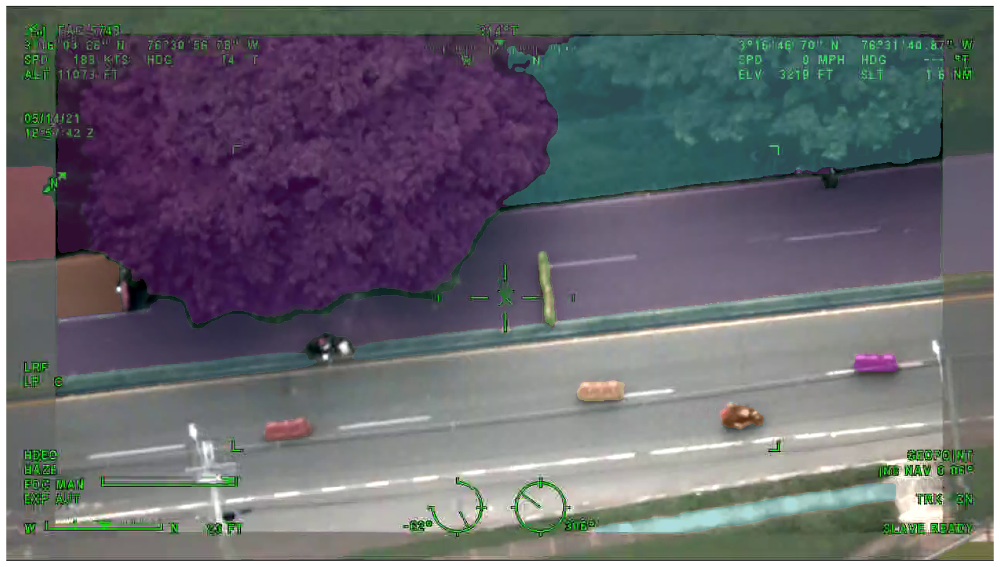

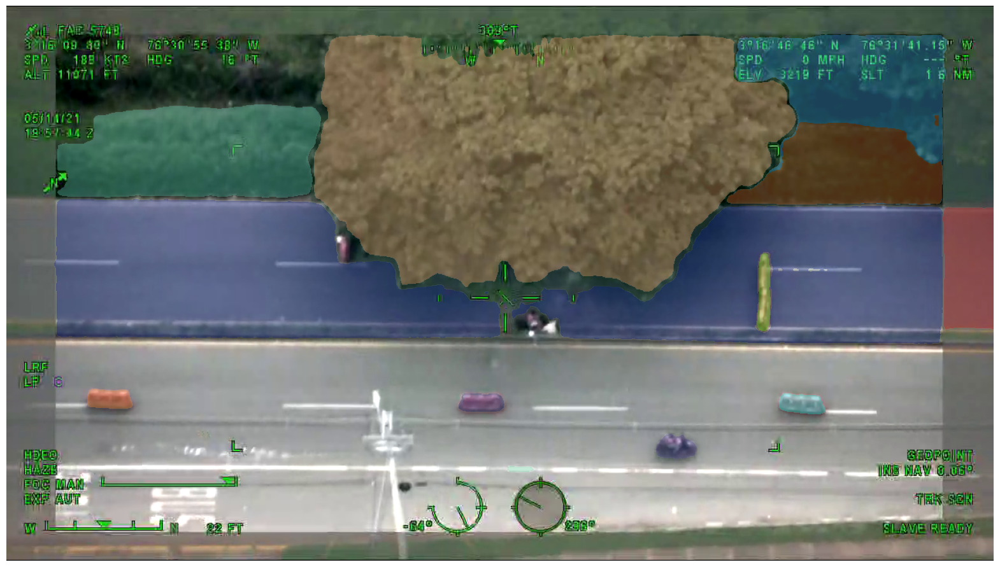

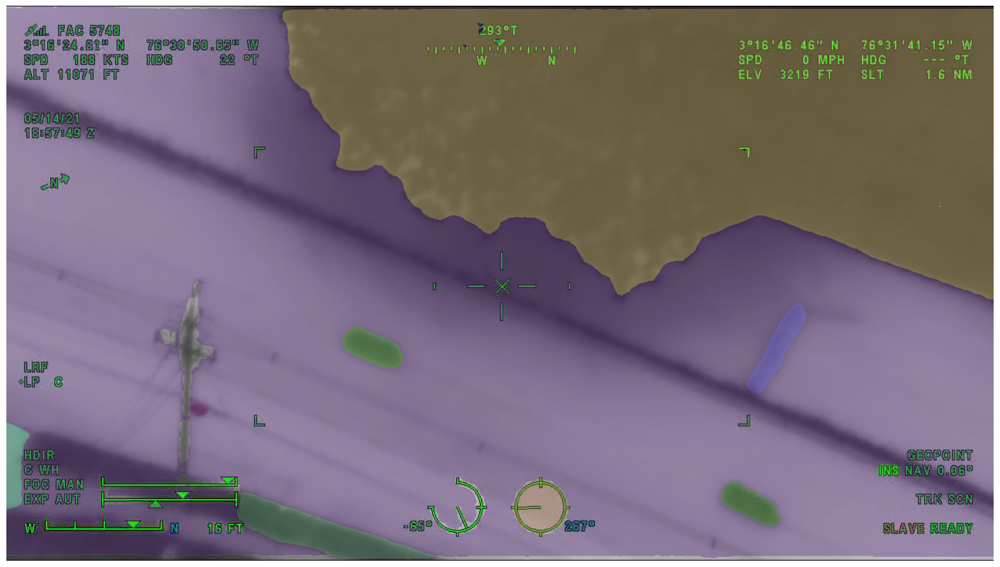

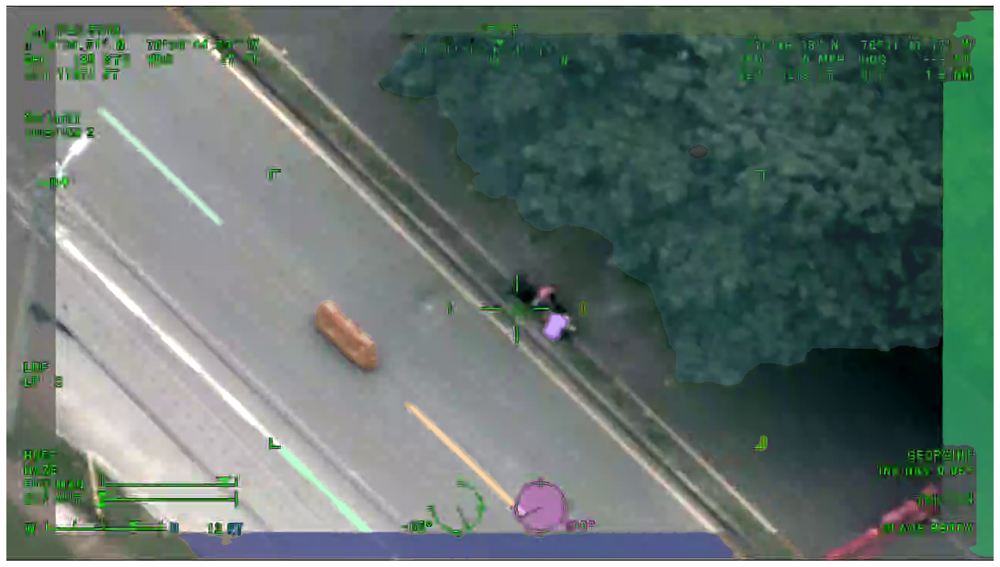

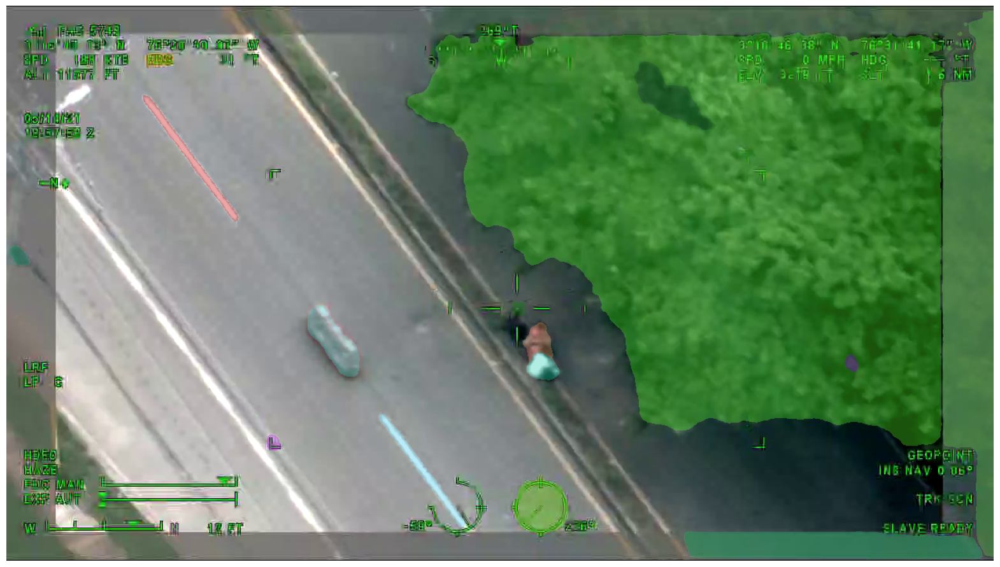

...

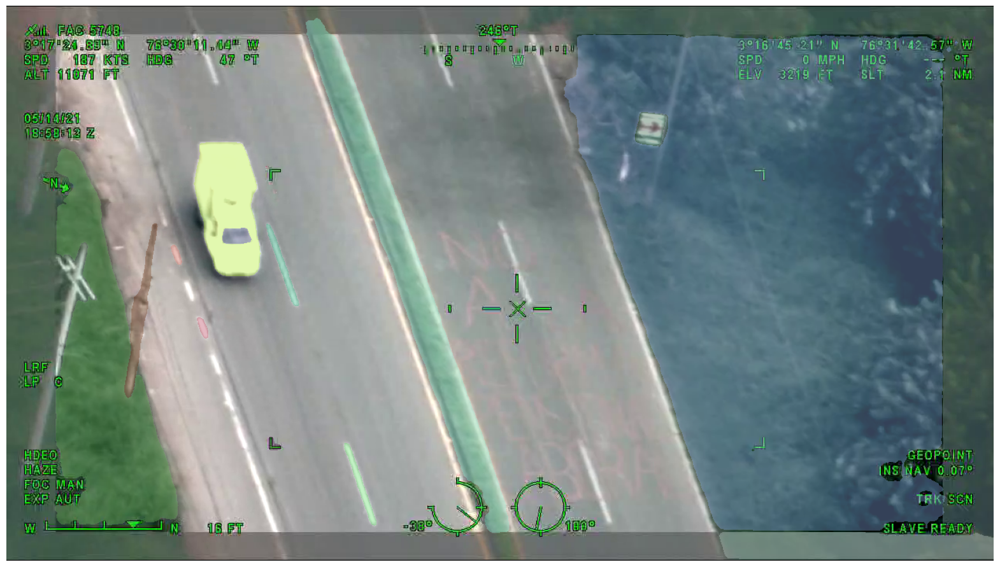

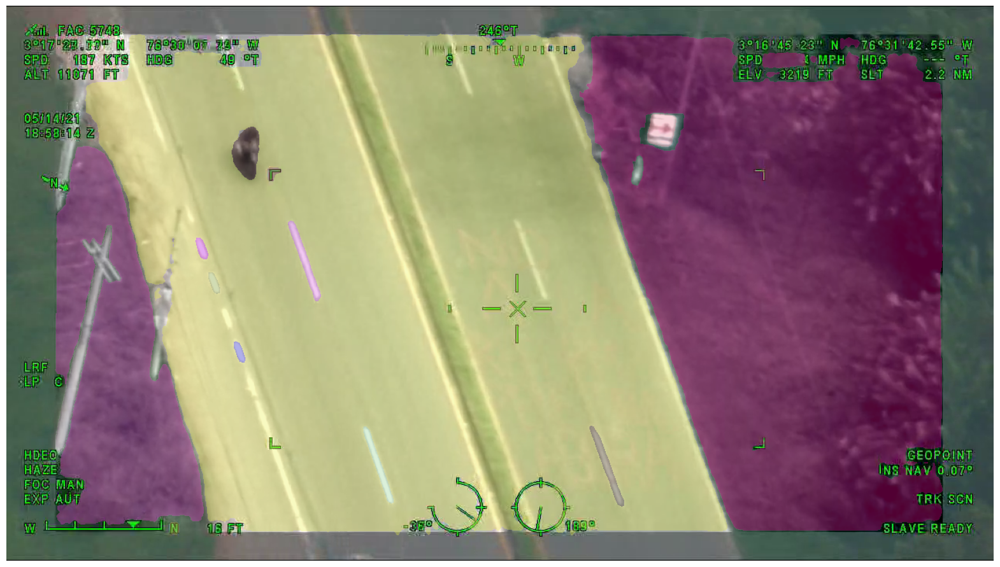

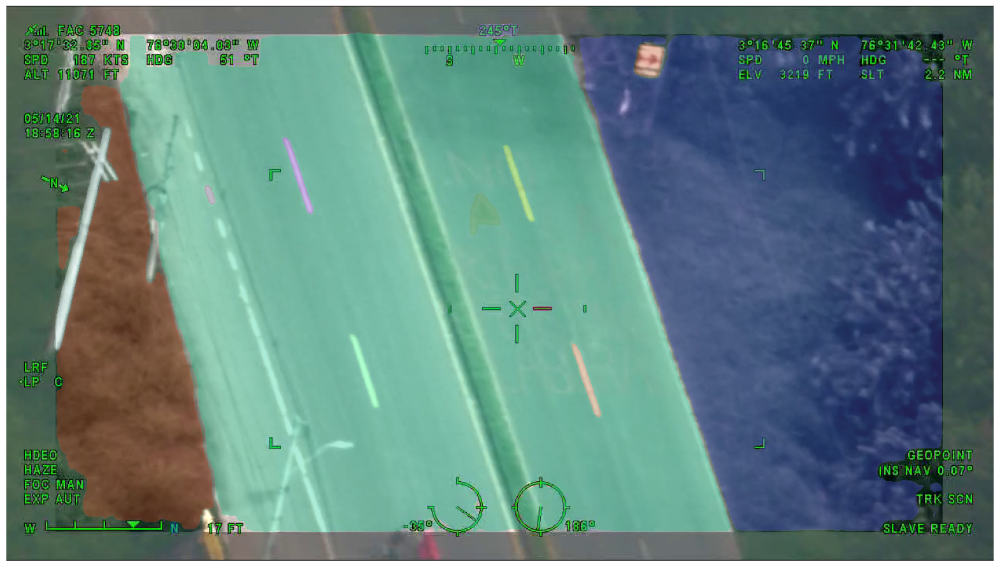

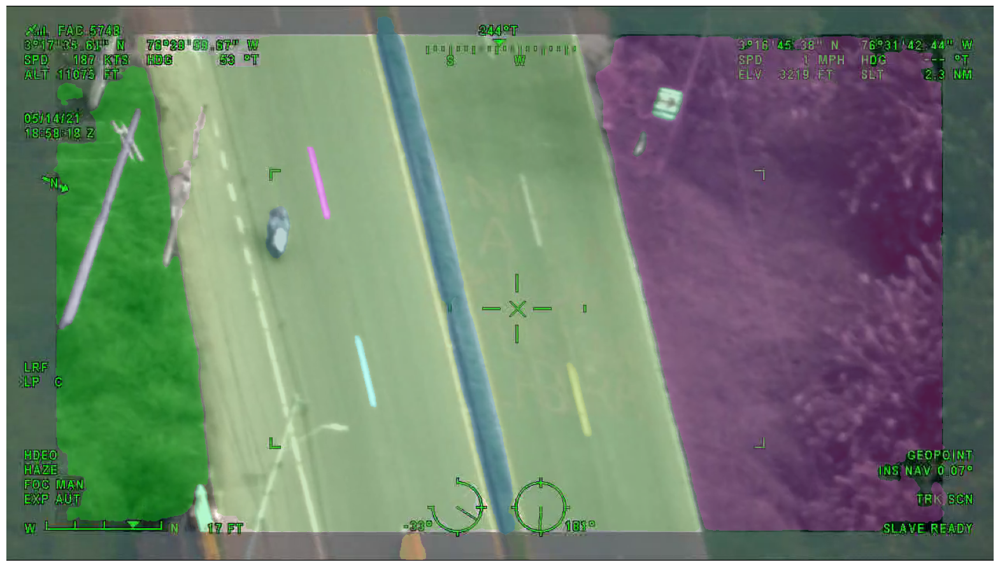

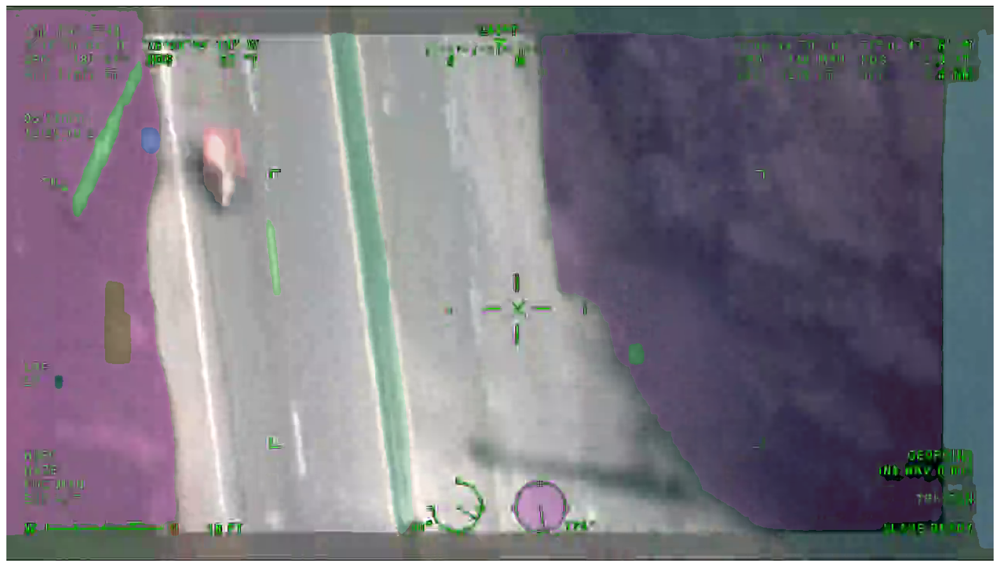

In [ ]:
detect_objects_in_video("/content/parte3.avi", "resultado_parte3.csv")

Reconocemos que la guia del CODEFEST exige que se exporte de manera automatica los elementos identificados en recuadros (que en este caso serían las segmentaciones) a una carpeta llamada IMG, sin embargo, aunque investigamos de manera extensiva, observamos que se nos dificultó lograrlo. De modo que es importante que el oficial de la FAC que use este sistema guarde y exporte de manera manual los fotogramas que resultaron del anterior procesamiento.

##Determinación de coordenadas mediante EasyOCR
Nuevamente, la dificultad de exportar adecuadamente la información de los fotogramas como las coordenadas nos motivó a investigar tutoriales que explicaran la forma en que podríamos solventar nuestras falencias de conocimiento técnico. Así, decidimos proponerle a la honorable Fuerza Aérea Colombiana que haga una selección manual de fotogramas para que en un string se arroje un resultado de las coordenadas identificadas mediante EasyOCR en las imagenes.

In [ ]:
%pwd
%cd
!pip install opencv
!pip install moviepy

/root
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement opencv (from versions: none)
ERROR: No matching distribution found for opencv
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Este código importa las librerías time, PIL y easyocr, que se usan para medir el tiempo, trabajar con imágenes y extraer texto de imágenes, respectivamente. Luego, crea un lector de easyocr para los idiomas español e inglés, usando la GPU para acelerar el proceso, y mide el tiempo que tarda en hacerlo. Después, lee una imagen de la ruta “/content/coordenadas.png” usando cv2, obtiene su ancho y alto, y aplica un umbral binario inverso para convertir la imagen en blanco y negro.



In [ ]:
import time
from PIL import Image
t_i = time.time()
reader = easyocr.Reader(["es"], gpu=True)
t_m = time.time()
print (f"ejecución: {t_m-t_i} segundos ")
image = cv2.imread("/content/coordenadas.png")
width = image.shape [1]
height = image.shape[0]
ret,image = cv2.threshold(image,100,255,cv2.THRESH_BINARY_INV)

ejecución: 3.7723865509033203 segundos 


Esta función recibe una imagen y devuelve la fecha, la hora y las coordenadas que se encuentran en el texto de la imagen. Para ello, usa el lector de easyocr para extraer el texto de la imagen, y lo divide en palabras. Luego, recorre las palabras buscando patrones que indiquen la fecha, la hora y las coordenadas, y las guarda en variables. Si no encuentra alguno de estos datos, asigna un mensaje de error a la variable correspondiente. Finalmente, devuelve una tupla con la fecha, la hora y las coordenadas. Después de llamar a la función con la imagen, se mide el tiempo final del proceso.

In [ ]:
def frame_ocr(image):
  result = reader.readtext(image, paragraph=True)
  date = "Ingrese una imagen con mayor legibilidad"
  hour = "Ingrese una imagen con mayor legibilidad"
  coord1 = "Ingrese una imagen con mayor legibilidad"
  coord2 = "Ingrese una imagen con mayor legibilidad"
  for res in result:
      text = res[1]
      chars = text.split (" ")
      for i in range( len(chars)):
        if (len(chars[i])==8):
          if ("/" in chars[i]):
            date = str(chars[i][0:2])+"/"+str(chars[i][3:5])+"/"+str(chars[i][6:8])
          elif ("8" in chars[i]):
              hour = str(chars[i][0:2])+":"+str(chars[i][3:5])+":"+str(chars[i][6:8])
      if (len (chars[i])>10) and (len(chars[i+1])>10):
          indx = len(chars[i])
          coord1 = str(chars[i][indx-11:indx-10])+"°"+str(chars[i][indx-9:indx-7])+"'"+str(chars[i][indx-6:indx-4])+"."+str(chars[i][indx-3:indx-1]) + '" N'
          coord2 = str(chars[i+1][indx-11:indx-9])+"°"+str(chars[i+1][indx-8:indx-6])+"'"+str(chars[i+1][indx-5:indx-3])+"."+str(chars[i+1][indx-2:indx]) + '" W'
      return (date,hour,(coord1,coord2))
date,hour,coordenadas = frame_ocr(image)
t_f = time.time()

In [ ]:
print (f"análisis de imagen: {t_f - t_m} segundos")
print (f"Fecha: {date}, Hora: {hour}, Coordenadas: {coordenadas}")

análisis de imagen: 60.715611696243286 segundos
Fecha: No detectada, por favor ingrese una imagen con mayor legibilidad, Hora: No detectada, por favor ingrese una imagen con mayor legibilidad, Coordenadas: ('No detectada, por favor ingrese una imagen con mayor legibilidad', 'No detectada, por favor ingrese una imagen con mayor legibilidad')


#**CONCLUSIONES**

El código desarrollado por el equipo Código Abierto del Amazonas es una herramienta innovadora que permite el análisis y monitoreo de la región amazónica mediante la segmentación e identificación de objetos de interés en imágenes geoespaciales desde tres frentes ya explicados. Esta herramienta tiene el potencial de apoyar la labor de la Fuerza Aérea Colombiana en la salvaguarda de este patrimonio natural invaluable para el país y el planeta.

Sin embargo, el código también enfrenta algunos retos y oportunidades de mejora, tales como la necesidad de incorporar más fuentes de datos geoespaciales, como imágenes satelitales, que pueden ofrecer una mayor cobertura y resolución temporal y espacial de la región amazónica (Gómez et al., 2019). Utilizar modelos de aprendizaje profundo para ir más allá de la segmentación semántica de las imágenes, y se mejore mediante entrenamiento concreto para obtener mayores indices de precisión en y generalización de la identificación de objetos (Zhang et al., 2020). Así como, aprender y poner en práctica más conocimientos y estrategias para evaluar el impacto ambiental y social de la herramienta, considerando los posibles riesgos éticos y legales de su uso (Kerle et al., 2021).

Este proyecto es un ejemplo de cómo el uso de datos geoespaciales puede contribuir al desarrollo sostenible y a la solución de problemas complejos que requieren una visión integral y multidisciplinaria. Además, es una oportunidad para que los estudiantes apliquen sus conocimientos y habilidades en un contexto real y colaboren con objetivos grandes del Estado Colombiano como los que están delegados en la honorable Fuerza Aérea Colombiana.








##**Referencias**

Gómez, C., White, J. C., & Wulder, M. A. (2019). Characterizing the state and processes of change in a dynamic moist tropical forest environment using Landsat time series. Remote Sensing of Environment, 232, 111294. https://doi.org/10.1016/j.rse.2019.111294

Zhang, Z., Liu, Q., & Wang, Y. (2020). Road Extraction by Deep Residual U-Net. IEEE Geoscience and Remote Sensing Letters, 17(2), 277-281. https://doi.org/10.1109/LGRS.2019.2919131

Kerle, N., Gerke, M., Nex, F., Duarte, D., & Vetrivel, A. (2021). Geospatial Computer Vision for Environmental Monitoring and Disaster Response: Opportunities and Challenges. Remote Sensing, 13(4), 784. https://doi.org/10.3390/rs13040784

Serrano-Cámara, L. M., & Serrano-Cámara, J. M. (2020). Visión artificial: Aplicaciones prácticas con OpenCV - Python. RC Libros.

Howse, J., & Minichino, J. (2020). Learning OpenCV 4 Computer Vision with Python 3: Get to grips with tools, techniques, and algorithms for computer vision and machine learning (3ra ed.). Packt Publishing. https://www.amazon.es/Learning-OpenCV-Computer-Vision-Python/dp/1789531616



